In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import csv
import scanpy.api as sc
from igraph import *
from MulticoreTSNE import MulticoreTSNE as TSNE #faster TSNE alternative
from anndata import read_h5ad
import dill # for saving everything


/home/ubuntu/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


# Load data

## 18, 21 and 24 months

In [2]:
path = '/data/maca/data/'
maca10x182124metadata = pd.read_csv('/data/maca/data/MACA_10x_18-21-24_qc.csv',usecols = ['channel','tissue','tissue.notes','mouse.age','mouse.sex'])

maca10x182124metadata = maca10x182124metadata.rename(columns = {'mouse.age':'age','mouse.sex':'sex','tissue.notes':'subtissue'})
maca10x182124metadata.index = range(len(maca10x182124metadata))

In [3]:
maca10x182124metadata.head()
#len(maca10x182124metadata)

,channel,age,sex,tissue,subtissue
0,MACA_18m_F_AORTA_50,18,F,AORTA,NaN
1,MACA_18m_F_BM_50,18,F,MARROW,NaN
2,MACA_18m_F_BM_51,18,F,MARROW,NaN
3,MACA_18m_F_BREAST_50,18,F,MAMMARY,NaN
4,MACA_18m_F_BREAST_51,18,F,MAMMARY,NaN


In [4]:
adata182124aux = []
for i in range(0,len(maca10x182124metadata)):
    path = '/data/maca/data/' + maca10x182124metadata.channel[i] + '/'
    foo = sc.read(path + 'matrix.mtx', cache=True).transpose()
    foo.var_names = np.genfromtxt(path + 'genes.tsv', dtype=str)[:, 1]
    foo.obs_names = np.genfromtxt(path + 'barcodes.tsv', dtype=str)
    foo.obs['Tissue'] = str(maca10x182124metadata.tissue[i]).title()
    #foo.obs['subTissue'] = str(maca10x182124metadata.subtissue[i]).title()
    
    
    if pd.isnull(maca10x182124metadata.subtissue[i]):
        foo.obs['subTissue'] = maca10x182124metadata.subtissue[i]
    else:        
        foo.obs['subTissue'] = str(maca10x182124metadata.subtissue[i]).title()
        
    
    foo.obs['Age'] = str(maca10x182124metadata.age[i]) + 'm'
    
    if maca10x182124metadata.sex[i] == 'M':
        foo.obs['Sex'] = 'male'
    else:
        foo.obs['Sex'] = 'female'
    sc.pp.filter_cells(foo, min_genes=250)
    
    foo.obs['Channel'] = maca10x182124metadata.channel[i]# + foo.obs_names.split("-")[0]
    
    foo.obs['Cell_Ontology_Type'] = 'NA' #maca10x3metadata.cell_ontology_class[i]
    #foo.obs['CellTypeID'] = maca10x3metadata.cell_ontology_id[i]
    #foo.obs['FreeAnn'] = maca10x3metadata.free_annotation[i]
    
    adata182124aux.append(foo)
    #print(adata3.X.size*8/1000000) # convert to Mb


first = adata182124aux.pop()
adata182124 = first.concatenate(adata182124aux)
adata182124.obs['Cell'] = adata182124.obs['Channel'] + '_' + adata182124.obs_names
adata182124.obs['Cell'] = adata182124.obs['Cell'].apply(lambda x: pd.Series(x.split('-')))[0]

adata182124.obs.head()

,Tissue,subTissue,Age,Sex,n_genes,Channel,Cell_Ontology_Type,batch,Cell
AAACCTGAGGCACATG-1-0,Tongue,NaN,24m,male,510,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACCTGAGGCACATG
AAACCTGCAGGGTACA-1-0,Tongue,NaN,24m,male,2107,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACCTGCAGGGTACA
AAACCTGCAGTAAGCG-1-0,Tongue,NaN,24m,male,3481,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACCTGCAGTAAGCG
AAACCTGTCATTATCC-1-0,Tongue,NaN,24m,male,2599,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACCTGTCATTATCC
AAACGGGAGATGAGAG-1-0,Tongue,NaN,24m,male,410,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACGGGAGATGAGAG


In [5]:
adata182124.obs

,Tissue,subTissue,Age,Sex,n_genes,Channel,Cell_Ontology_Type,batch,Cell
AAACCTGAGGCACATG-1-0,Tongue,NaN,24m,male,510,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACCTGAGGCACATG
AAACCTGCAGGGTACA-1-0,Tongue,NaN,24m,male,2107,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACCTGCAGGGTACA
AAACCTGCAGTAAGCG-1-0,Tongue,NaN,24m,male,3481,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACCTGCAGTAAGCG
AAACCTGTCATTATCC-1-0,Tongue,NaN,24m,male,2599,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACCTGTCATTATCC
AAACGGGAGATGAGAG-1-0,Tongue,NaN,24m,male,410,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACGGGAGATGAGAG
AAACGGGGTACAGTGG-1-0,Tongue,NaN,24m,male,3468,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACGGGGTACAGTGG
AAACGGGGTCAATACC-1-0,Tongue,NaN,24m,male,537,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACGGGGTCAATACC
AAACGGGGTCTTCTCG-1-0,Tongue,NaN,24m,male,3189,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACGGGGTCTTCTCG
AAACGGGTCATGTCCC-1-0,Tongue,NaN,24m,male,504,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACGGGTCATGTCCC
AAAGATGAGCTATGCT-1-0,Tongue,NaN,24m,male,3419,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAAGATGAGCTATGCT


## 3months

In [46]:
path = '/data/maca/data/10x/'
maca10x3metadata = pd.read_csv('/data/maca/data/10x/MACA_10x_3_qc.csv',usecols = ['channel','tissue','tissue.notes','mouse.age','mouse.sex','pool'])
maca10x3metadata2 = pd.read_csv('/data/maca/data/10x/TM_droplet_metadata.csv', low_memory=False)

maca10x3metadata = maca10x3metadata.rename(columns = {'mouse.age':'age','mouse.sex':'sex','tissue.notes':'subtissue'})
#maca10x3metadata = maca10x3metadata[maca10x3metadata.age == 3]
maca10x3metadata.index = range(len(maca10x3metadata))

maca10x3metadata.head()

,channel,tissue,subtissue,age,sex,pool
0,10X_P4_0,Tongue,TONGUE,3,M,4
1,10X_P4_1,Tongue,TONGUE,3,M,4
2,10X_P4_2,Liver,HEPATOCYTES,3,M,4
3,10X_P4_3,Bladder,BLADDER,3,M,4
4,10X_P4_4,Bladder,BLADDER,3,M,4


In [47]:
adata3aux = []
for i in range(0,len(maca10x3metadata)):
    #print(i)
    path = '/data/maca/data/10x/' + maca10x3metadata.channel[i] + '/'
    foo = sc.read(path + 'matrix.mtx', cache=True).transpose()
    foo.var_names = np.genfromtxt(path + 'genes.tsv', dtype=str)[:, 1]
    foo.obs_names = np.genfromtxt(path + 'barcodes.tsv', dtype=str)
    foo.obs['Tissue'] = maca10x3metadata.tissue[i]
    foo.obs['subTissue'] = maca10x3metadata.subtissue[i]
    foo.obs['Age'] = str(maca10x3metadata.age[i]) + 'm'
    
    if maca10x3metadata.sex[i] == 'M':
        foo.obs['Sex'] = 'male'
    else:
        foo.obs['Sex'] = 'female'
    sc.pp.filter_cells(foo, min_genes=250)
    
    foo.obs['Channel'] = maca10x3metadata.channel[i]# + foo.obs_names.split("-")[0]
    
    foo.obs['Cell_Ontology_Type'] = 'NA' #maca10x3metadata.cell_ontology_class[i]
    #foo.obs['CellTypeID'] = maca10x3metadata.cell_ontology_id[i]
    #foo.obs['FreeAnn'] = maca10x3metadata.free_annotation[i]
    
    adata3aux.append(foo)
    #print(adata3.X.size*8/1000000) # convert to Mb

first = adata3aux.pop()
adata3 = first.concatenate(adata3aux)
adata3.obs['Cell'] = adata3.obs['Channel'] + '_' + adata3.obs_names
adata3.obs['Cell'] = adata3.obs['Cell'].apply(lambda x: pd.Series(x.split('-')))[0]

display(adata3.obs.head())
adata3

,Tissue,subTissue,Age,Sex,n_genes,Channel,Cell_Ontology_Type,batch,Cell
AAACCTGAGAGCCCAA-1-0,Trachea,NaN,3m,male,669,10X_P8_15,NA,0,10X_P8_15_AAACCTGAGAGCCCAA
AAACCTGAGCTAGTCT-1-0,Trachea,NaN,3m,male,1071,10X_P8_15,NA,0,10X_P8_15_AAACCTGAGCTAGTCT
AAACCTGAGGATGTAT-1-0,Trachea,NaN,3m,male,1311,10X_P8_15,NA,0,10X_P8_15_AAACCTGAGGATGTAT
AAACCTGAGGGATACC-1-0,Trachea,NaN,3m,male,1804,10X_P8_15,NA,0,10X_P8_15_AAACCTGAGGGATACC
AAACCTGAGTTTAGGA-1-0,Trachea,NaN,3m,male,1085,10X_P8_15,NA,0,10X_P8_15_AAACCTGAGTTTAGGA


AnnData object with n_obs × n_vars = 58510 × 23433 
    obs: 'Tissue', 'subTissue', 'Age', 'Sex', 'n_genes', 'Channel', 'Cell_Ontology_Type', 'batch', 'Cell'

## concatenate all time points

In [48]:
adata = adata182124.concatenate([adata3])
adata.write('./write/maca.h5ad')

In [ ]:
import gc
gc.collect()

# Import all data

In [ ]:
adata = read_h5ad('./write/maca.h5ad')
type(adata.X)


In [49]:
adata.shape

(279157, 23433)

In [50]:
adata

AnnData object with n_obs × n_vars = 279157 × 23433 
    obs: 'Tissue', 'subTissue', 'Age', 'Sex', 'n_genes', 'Channel', 'Cell_Ontology_Type', 'batch', 'Cell'

In [51]:
adata.obs.head()

,Tissue,subTissue,Age,Sex,n_genes,Channel,Cell_Ontology_Type,batch,Cell
AAACCTGAGGCACATG-1-0-0,Tongue,NaN,24m,male,510,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACCTGAGGCACATG
AAACCTGCAGGGTACA-1-0-0,Tongue,NaN,24m,male,2107,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACCTGCAGGGTACA
AAACCTGCAGTAAGCG-1-0-0,Tongue,NaN,24m,male,3481,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACCTGCAGTAAGCG
AAACCTGTCATTATCC-1-0-0,Tongue,NaN,24m,male,2599,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACCTGTCATTATCC
AAACGGGAGATGAGAG-1-0-0,Tongue,NaN,24m,male,410,MACA_24m_M_TONGUE_60,NA,0,MACA_24m_M_TONGUE_60_AAACGGGAGATGAGAG


# Preprocessing

In [52]:
sc.pp.filter_genes(adata, min_cells=5)
sc.pp.filter_cells(adata, min_genes=250)
adata

AnnData object with n_obs × n_vars = 279156 × 19614 
    obs: 'Tissue', 'subTissue', 'Age', 'Sex', 'n_genes', 'Channel', 'Cell_Ontology_Type', 'batch', 'Cell'
    var: 'n_cells'

In [53]:
# add the total counts per cell as observations-annotation to adata
adata.obs['n_counts'] = np.sum(adata.X, axis=1).A1
adata

AnnData object with n_obs × n_vars = 279156 × 19614 
    obs: 'Tissue', 'subTissue', 'Age', 'Sex', 'n_genes', 'Channel', 'Cell_Ontology_Type', 'batch', 'Cell', 'n_counts'
    var: 'n_cells'

... storing 'Tissue' as categorical
... storing 'subTissue' as categorical
... storing 'Age' as categorical
... storing 'Sex' as categorical
... storing 'Channel' as categorical
... storing 'Cell_Ontology_Type' as categorical


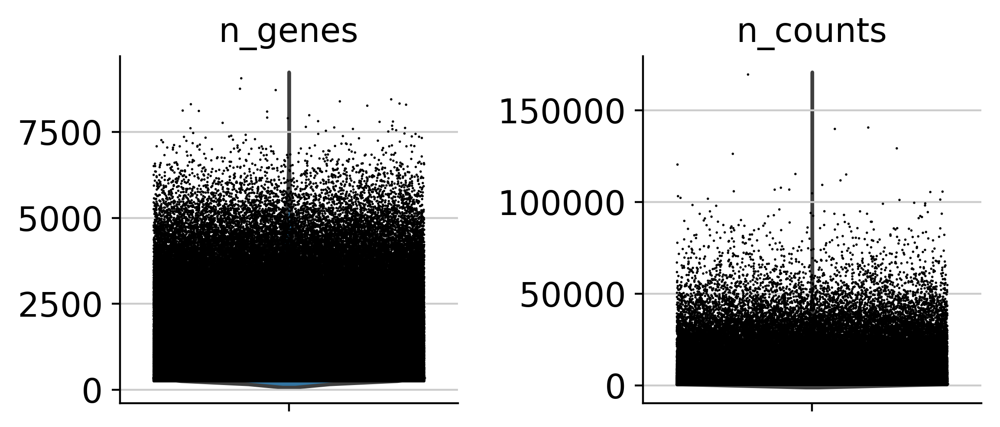

In [54]:
axs = sc.pl.violin(adata, ['n_genes', 'n_counts'],
                   jitter=0.4, multi_panel=True)

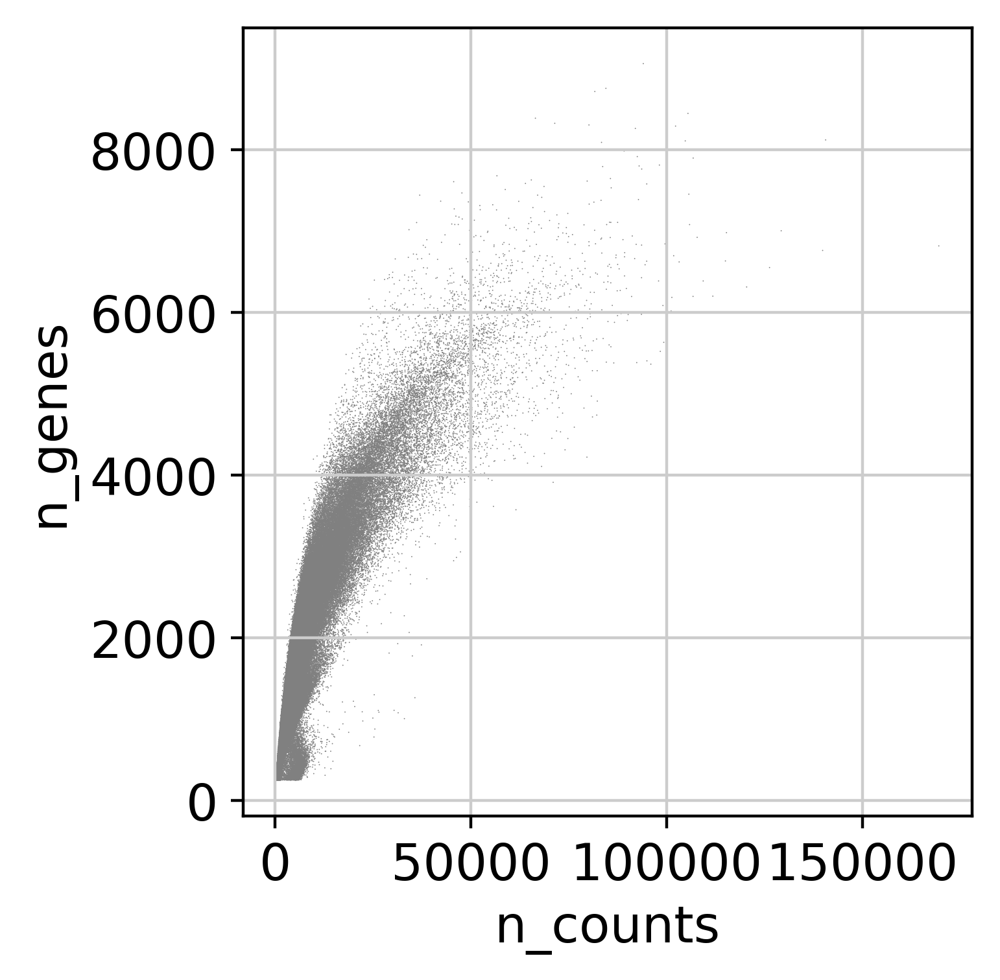

In [55]:
ax = sc.pl.scatter(adata, x='n_counts', y='n_genes')

In [56]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4) #simple lib size normalization?
adata.raw = adata

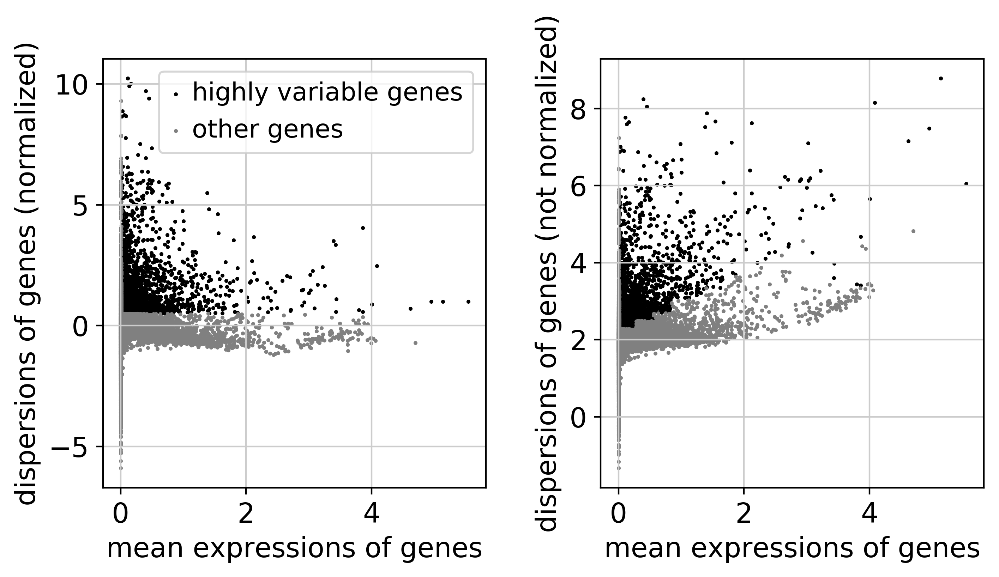

In [57]:
filter_result = sc.pp.filter_genes_dispersion(
    adata.X, min_mean=0.0125, max_mean=10, min_disp=0.5)
sc.pl.filter_genes_dispersion(filter_result)

In [58]:
adata = adata[:, filter_result.gene_subset]
adata.shape

(279156, 2202)

In [59]:
sc.pp.log1p(adata)

In [60]:
sc.pp.scale(adata, max_value=10, zero_center=False)

# Exploration
## PCA

In [61]:
sc.tl.pca(adata)

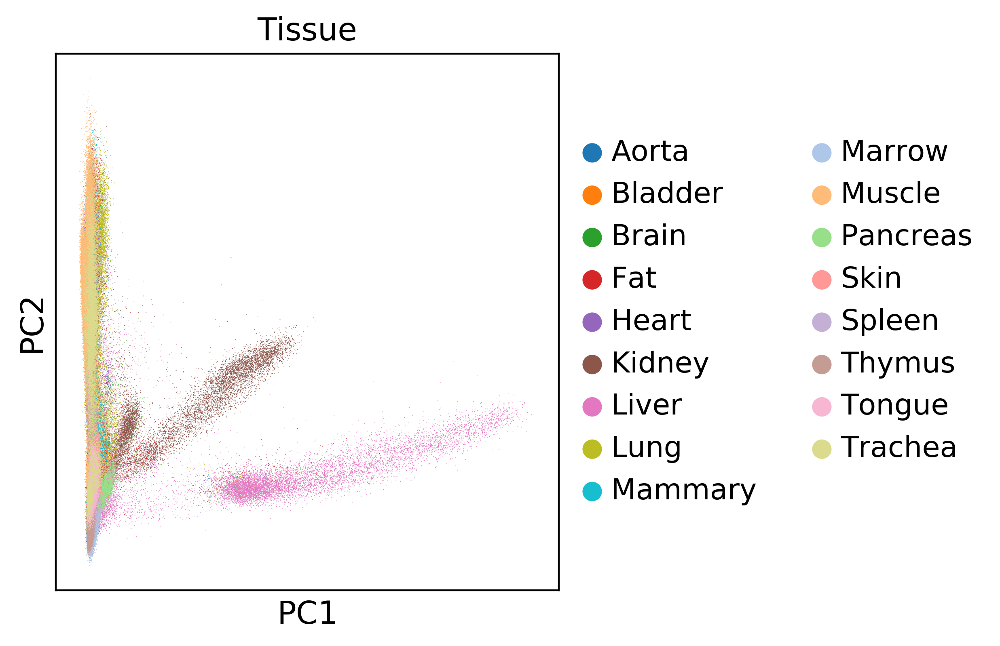

In [62]:
ax = sc.pl.pca_scatter(adata, color=['Tissue'], right_margin=0.5)

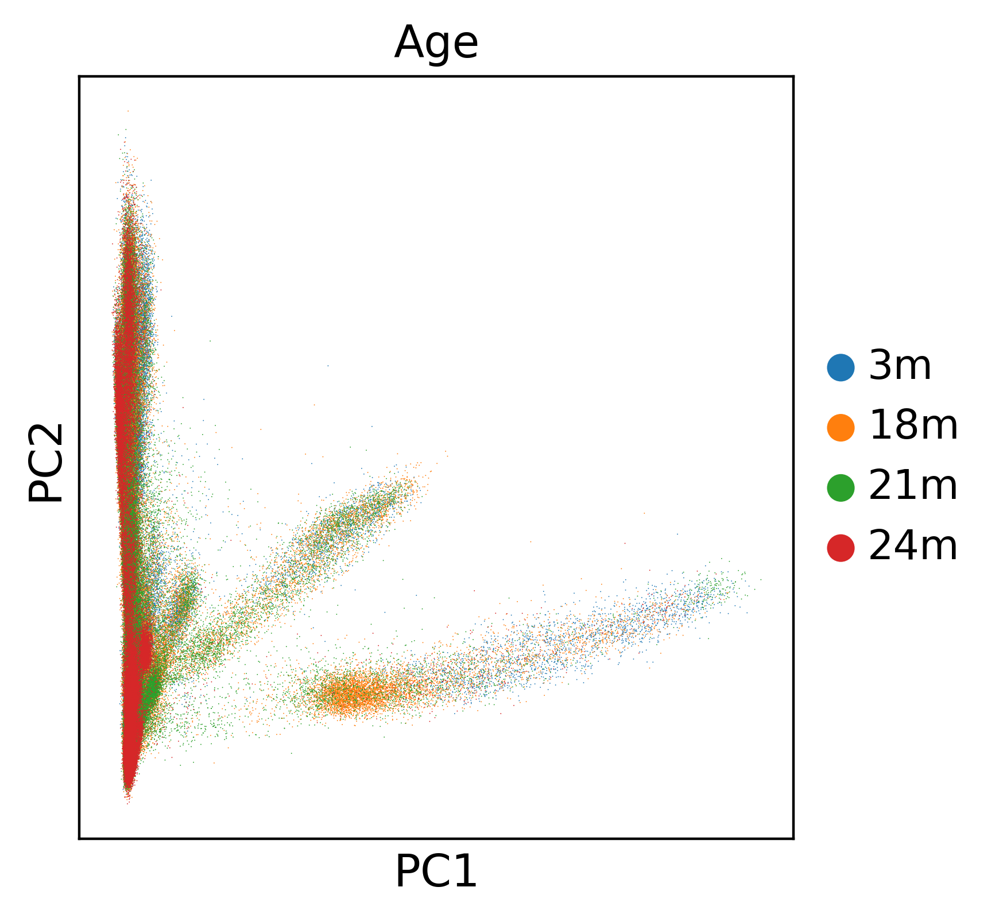

In [63]:
ax = sc.pl.pca_scatter(adata, color=['Age'], right_margin=0.5)

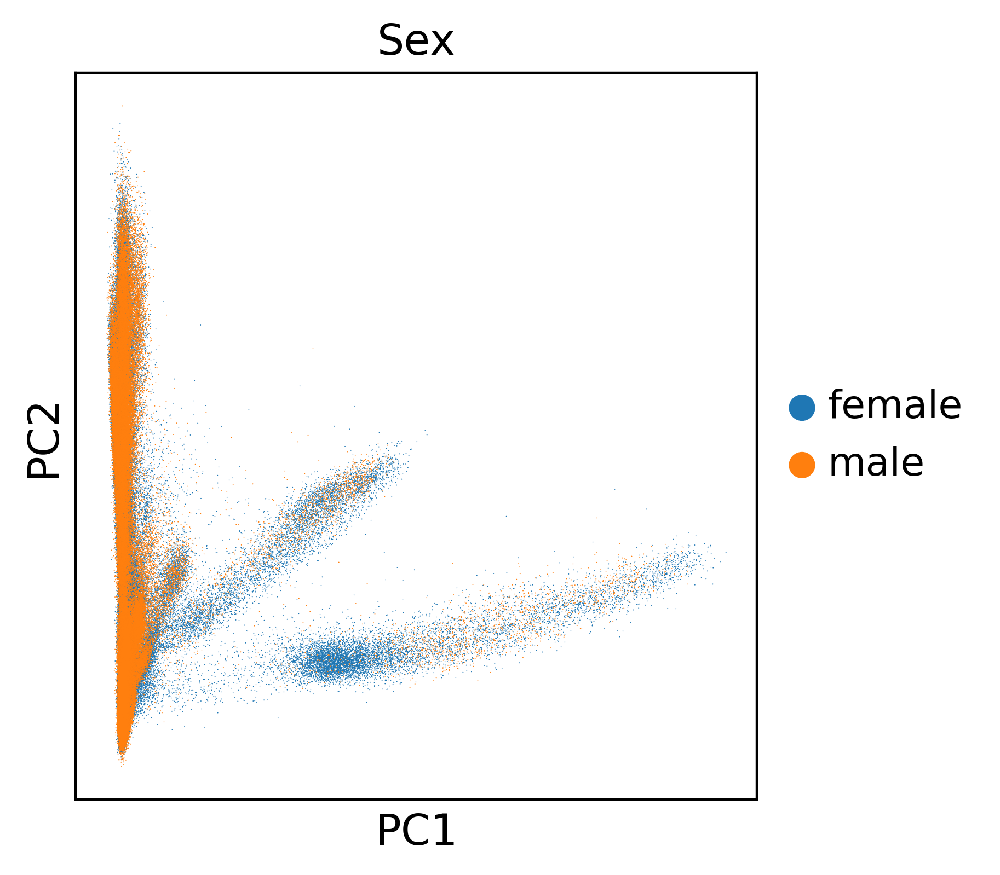

In [64]:
ax = sc.pl.pca_scatter(adata, color=['Sex'], right_margin=0.5)

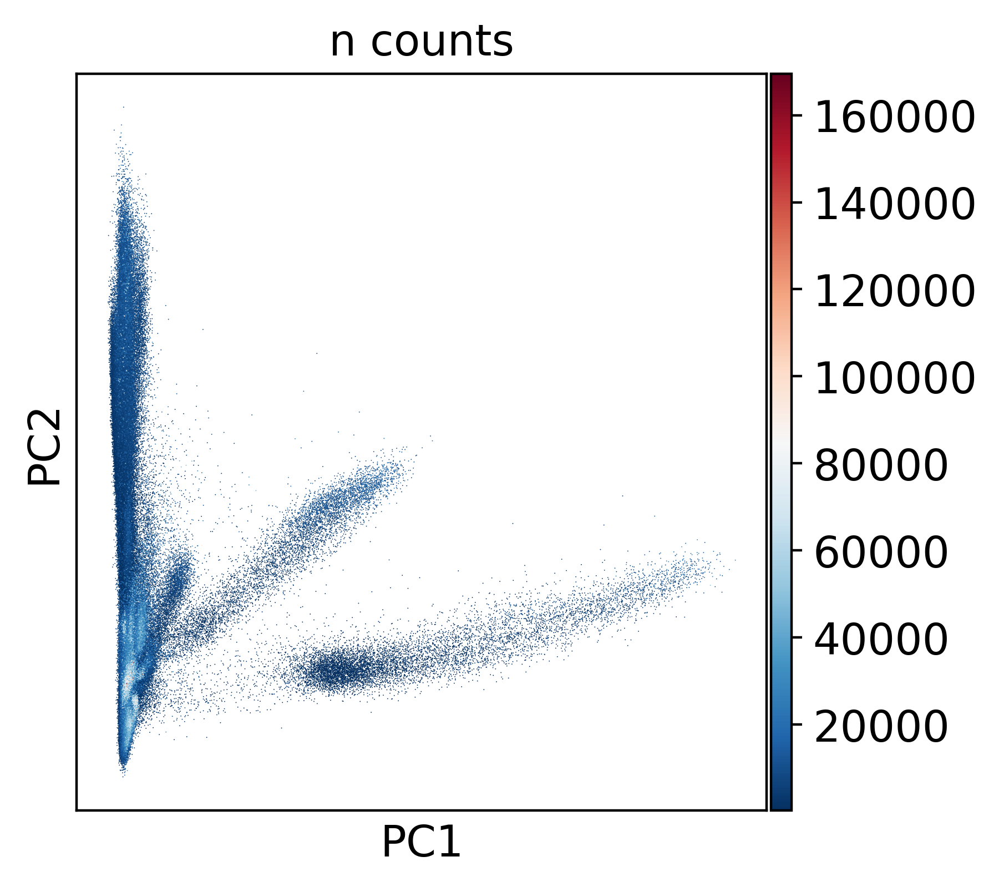

In [65]:
ax = sc.pl.pca_scatter(adata, color='n_counts', right_margin=0.5)

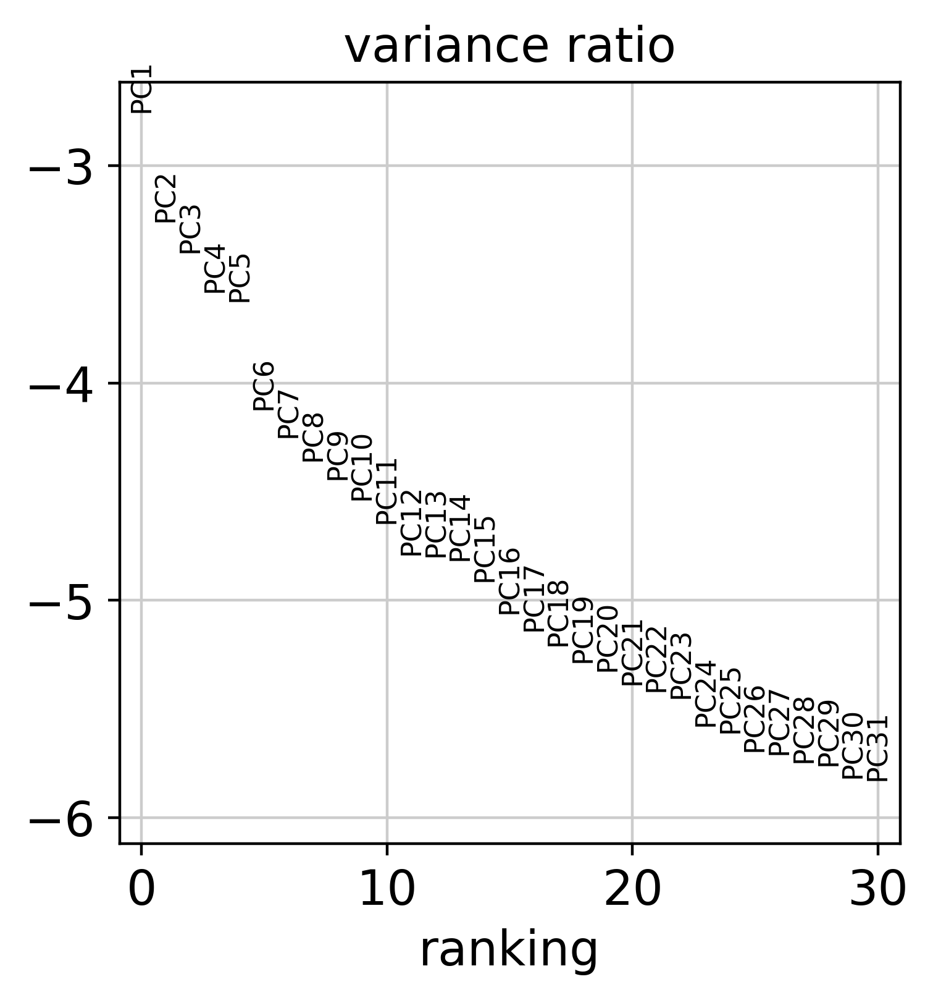

In [66]:
sc.pl.pca_variance_ratio(adata, log=True)

## Louvain clustering

In [67]:
sc.pp.neighbors(adata, n_neighbors=15)#, method='gauss')
sc.tl.louvain(adata, resolution = 0.3)

In [68]:
adata

AnnData object with n_obs × n_vars = 279156 × 2202 
    obs: 'Tissue', 'subTissue', 'Age', 'Sex', 'n_genes', 'Channel', 'Cell_Ontology_Type', 'batch', 'Cell', 'n_counts', 'louvain'
    var: 'n_cells'
    uns: 'pca', 'Tissue_colors', 'Age_colors', 'Sex_colors', 'neighbors', 'louvain'
    obsm: 'X_pca'
    varm: 'PCs'

## UMAP

In [69]:
sc.tl.umap(adata)

saving figure to file ./figures/umap_all_ages_tissue.pdf


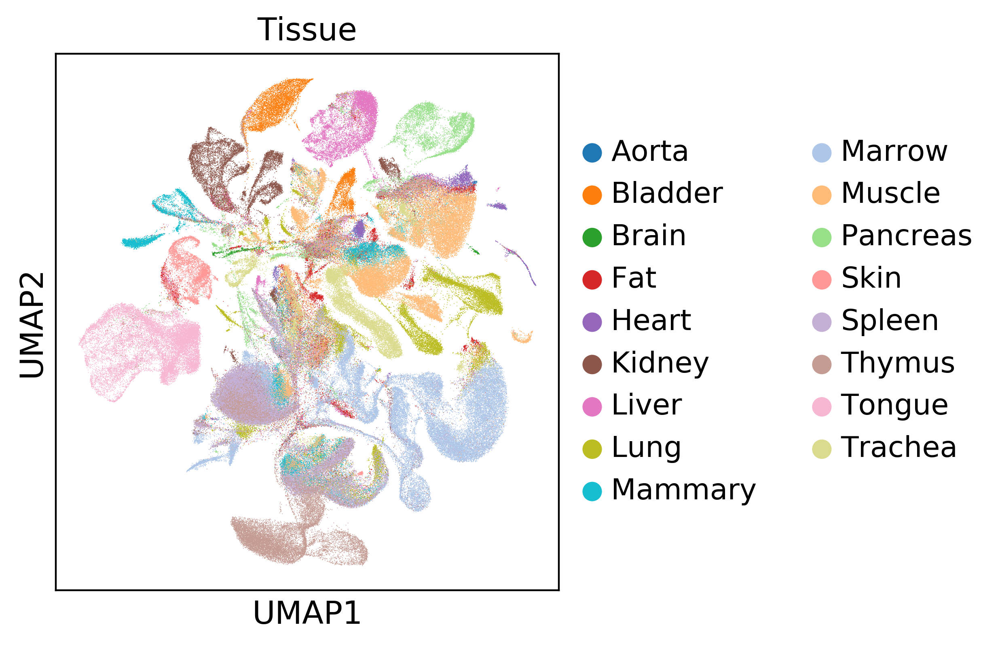

In [80]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color=['Tissue'], right_margin=0.5, save='_all_ages_tissue.pdf')

saving figure to file ./figures/umap_all_ages_age.pdf


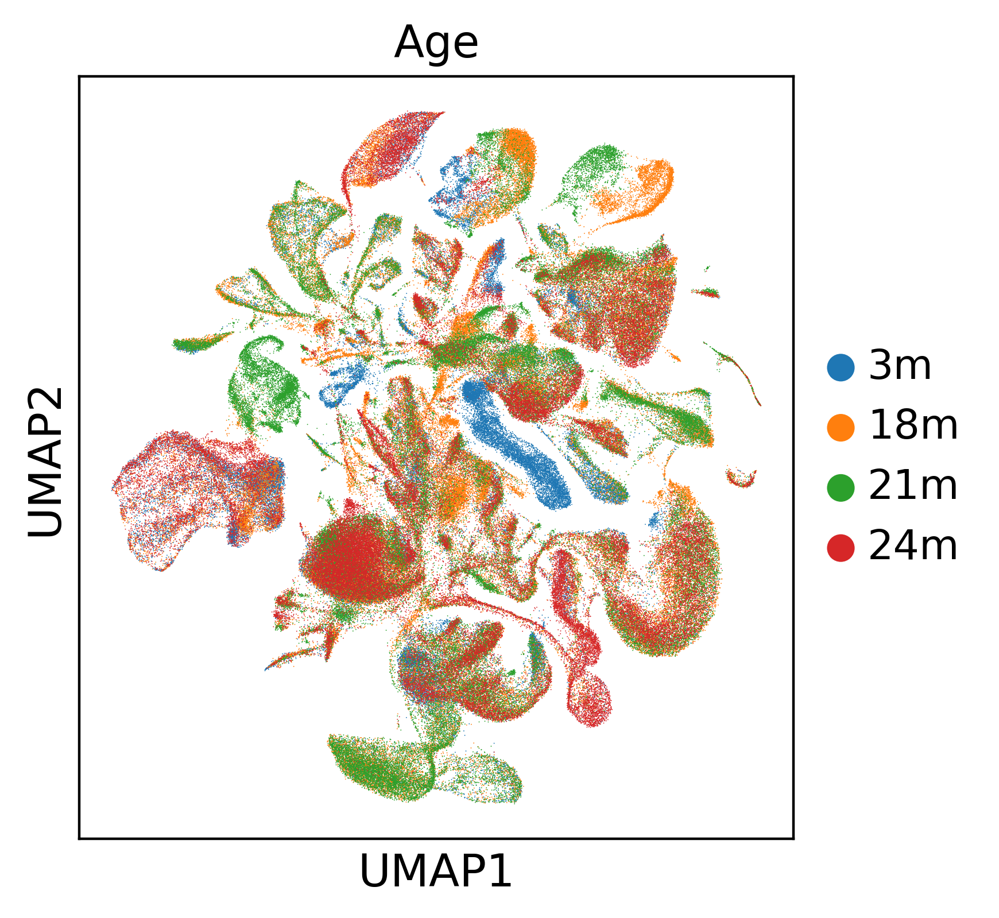

In [81]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color=['Age'], right_margin=0.5, save='_all_ages_age.pdf')

saving figure to file ./figures/umap_all_ages_sex.pdf


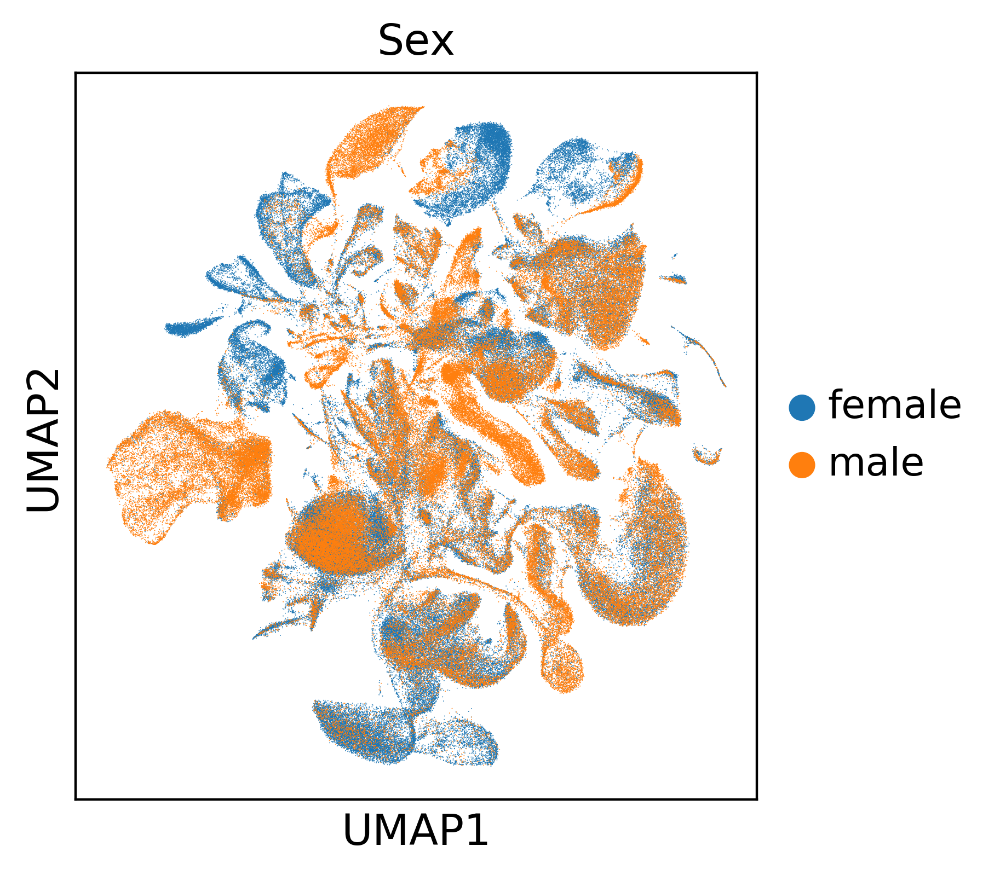

In [87]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color=['Sex'], right_margin=0.5, save='_all_ages_sex.pdf')

saving figure to file ./figures/umap_all_ages_louvain.pdf


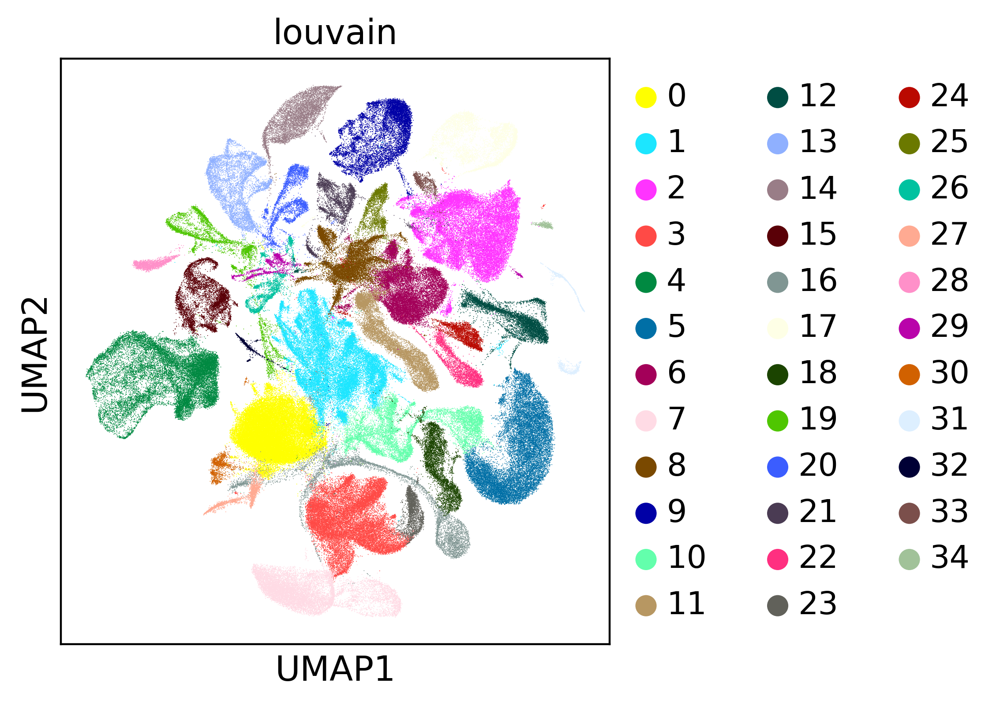

In [82]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color=['louvain'], right_margin=0.5, save='_all_ages_louvain.pdf')

## tSNE

In [73]:
sc.tl.tsne(adata, perplexity=50)

saving figure to file ./figures/tsne_all_ages_tissue.pdf


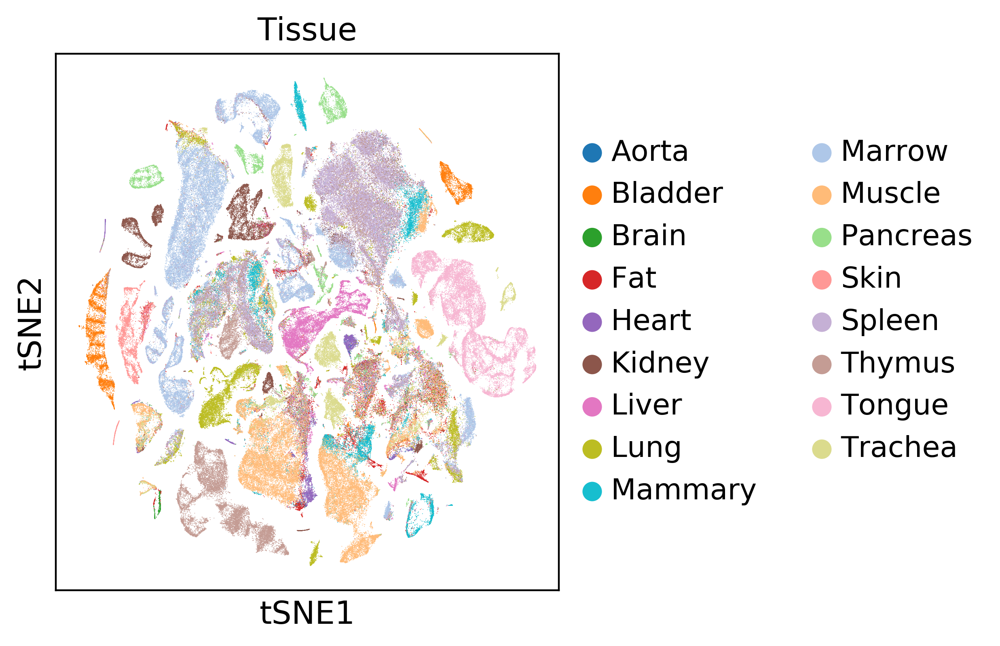

In [83]:
sc.settings.set_figure_params(dpi=200)
sc.pl.tsne(adata, color=['Tissue'], right_margin=0.5, save='_all_ages_tissue.pdf')

saving figure to file ./figures/tsne_all_ages_age.pdf


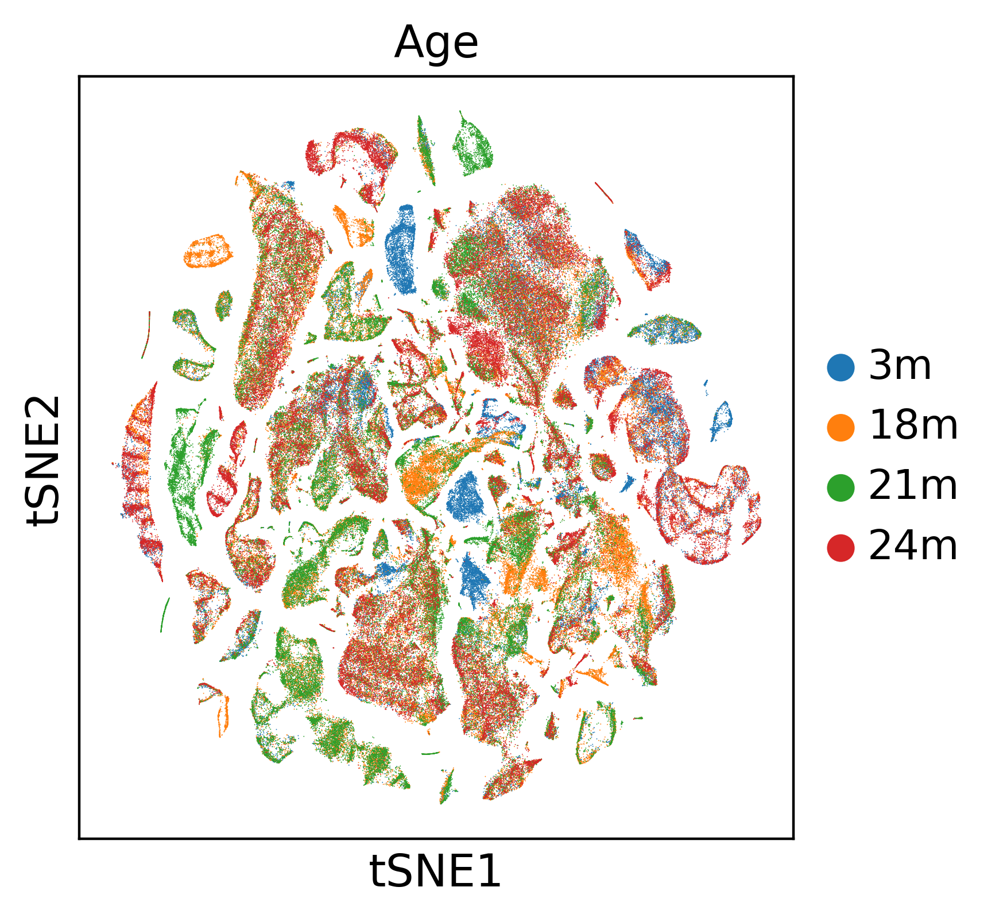

In [86]:
sc.pl.tsne(adata, color=['Age'], right_margin=0.5, save='_all_ages_age.pdf')

saving figure to file ./figures/tsne_all_ages_sex.pdf


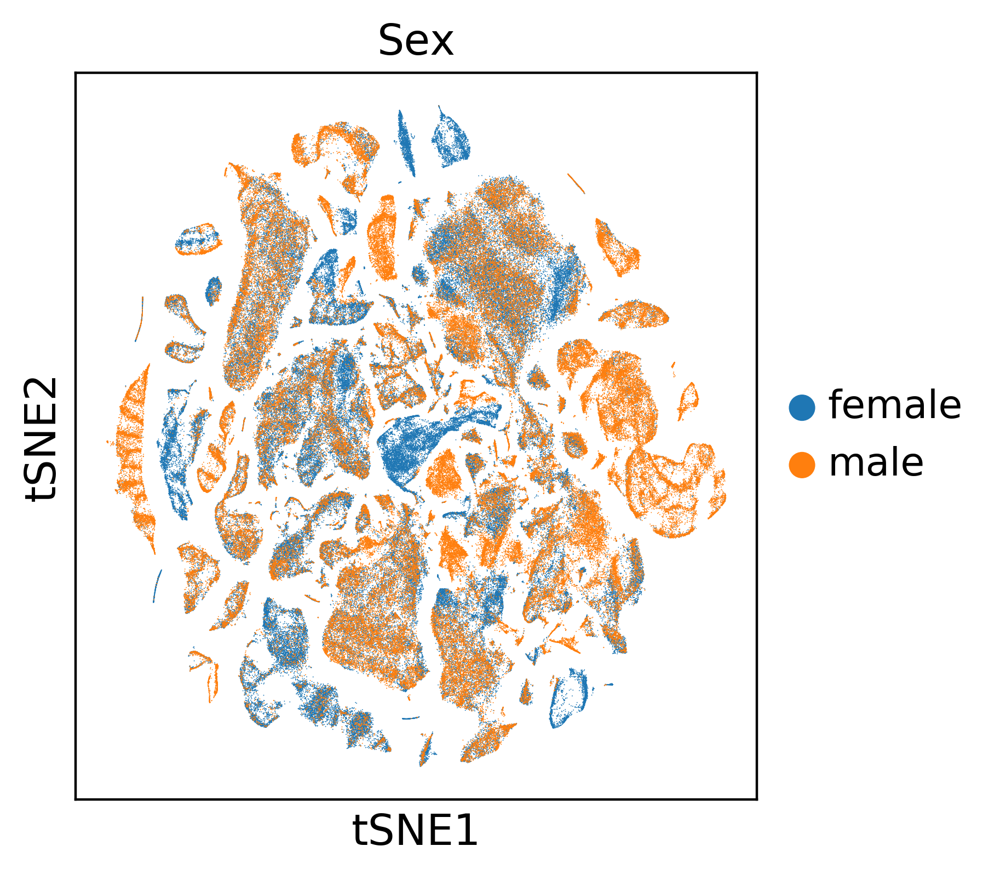

In [84]:
sc.pl.tsne(adata, color=['Sex'], right_margin=0.5, save='_all_ages_sex.pdf')

saving figure to file ./figures/tsne_all_ages_louvain.pdf


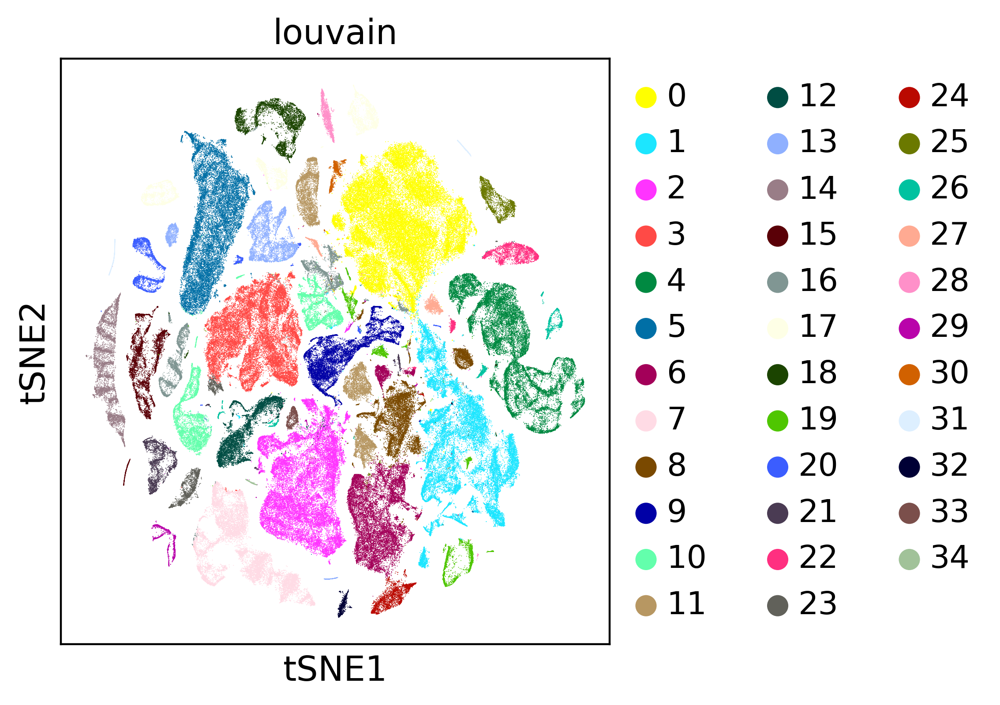

In [85]:
sc.pl.tsne(adata, color=['louvain'], right_margin=0.5, save='_all_ages_louvain.pdf')

# Save processed data

In [88]:
adata.write('./write/maca.processed.h5ad')